In [2]:
# autoreload libraries
%load_ext autoreload
%autoreload 2

import pandas as pd

import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import seaborn as sns
import numpy as np
import folium
from folium.map import Element
from shapely import affinity
import seaborn as sns
from IPython.display import Markdown as md
from IPython.display import display, HTML

import xyzservices.providers as xyz

from nycschools import schools, geo, snapshot as snap
from maptools import ui

import warnings
warnings.filterwarnings('ignore')

In [3]:
# load all of the data and clean it up
loc = geo.load_school_locations()
districts = geo.load_districts()
demos = schools.load_school_demographics()


In [4]:

feet = gpd.read_file("/home/mxc/Projects/school-data-portal/school-data/nyc-building-footprints.geojson")

feet.head()

,name,base_bbl,shape_area,heightroof,mpluto_bbl,cnstrct_yr,globalid,lststatype,feat_code,groundelev,geomsource,bin,lstmoddate,doitt_id,shape_len,geometry
0,None,3065220021,0.0,29.74985318,3065220021,1925,{31298F86-3088-4F53-B3DB-71A9EFA6FA1F},Constructed,2100,40,Photogramm,3170958,2017-08-22,96807,0.0,"MULTIPOLYGON (((-73.96665 40.626, -73.96685 40..."
1,None,5012640036,0.0,22.63,5012640036,1965,{F5F8CDA5-69E2-46F8-8F69-BA95C025B520},Constructed,2100,39,Photogramm,5028452,2017-08-22,326368,0.0,"MULTIPOLYGON (((-74.1679 40.63936, -74.1679 40..."
2,None,5060190091,0.0,35.76,5060190091,1970,{9F644794-F72C-4582-9E5E-B337E2B97068},Constructed,2100,51,Photogramm,5078368,2017-08-22,746627,0.0,"MULTIPOLYGON (((-74.19511 40.55611, -74.1952 4..."
3,None,3086910048,0.0,37.5,3086910048,1928,{F916B22D-E25B-44AE-9FA9-2A51191B9CDF},Constructed,2100,6,Photogramm,3245111,2017-08-22,786626,0.0,"MULTIPOLYGON (((-73.96113 40.57744, -73.96115 ..."
4,None,4075020005,0.0,18.01511294,4075020005,1950,{525F2C24-616B-4F29-98A3-8FEA5D4B1A7D},Constructed,2100,93,Photogramm,4161096,2017-08-22,746409,0.0,"MULTIPOLYGON (((-73.75422 40.75591, -73.75417 ..."


In [26]:
hs = demos[(demos.grade_9 > 0) | (demos.grade_10 > 0) | (demos.grade_11 > 0) | (demos.grade_12 > 0)].copy()
hs = hs[hs.ay == hs.ay.max()]
hs = hs[['dbn', 'beds', 'district', 'geo_district', 'boro', 'school_name',
   'ay', 'year', 'school_type', 'total_enrollment',
   'asian_n', 'asian_pct', 'black_n', 'black_pct', 'hispanic_n',
   'hispanic_pct', 'multi_racial_n', 'multi_racial_pct',
   'native_american_n', 'native_american_pct', 'white_n', 'white_pct',
   'missing_race_ethnicity_data_n', 'missing_race_ethnicity_data_pct',
   'swd_n', 'swd_pct', 'ell_n', 'ell_pct', 'poverty_n', 'poverty_pct',
   'eni','zip']]

hs["plurality"] = hs[['asian_n', 'black_n', 'hispanic_n', 'multi_racial_n', 'native_american_n', 'white_n']].idxmax(axis=1)
hs.plurality = hs.plurality.str.replace("_n", "")

def pick_color(x):
    default = "purple"
    demo_colors = {
        "asian": "darkred",
        "black": "darkblue",
        "hispanic": "darkgreen",
        "white": "darkorange",
        "poverty": "purple",
    }
    c = demo_colors.get(x, default)
    return c


hs["color"] = hs.plurality.apply(pick_color)


def demo_popup(row):
    demo_labels = {
        "asian_pct": "Asian Students (%)",
        "black_pct": "Black Students (%)",
        "hispanic_pct": "Latinx Students (%)",
        "white_pct": "White Students (%)",
        "poverty_pct": "Poverty Rate (%)"
    }
    bars = []
    for k, v in demo_labels.items():
        color_key = k.split("_")[0]
        color = pick_color(color_key)
        width = row[k] * 120
        pct = row[k]
        label = demo_labels[k]
        bar = f"""
  <div style="display: flex; margin-bottom: 2px; height: 16px; align-items: center">
    <div style="width: 120px; text-align: right; padding-right: 5px; font-weight: bold; font-size: 12px;">{label}</div>
    <div title="{pct:.1%}" style="flex-grow: 1;cursor: pointer; background-color:gray"><div style="background-color: {color}; height: 10px; width: {width}px;"></div></div>
  </div>"""
        bars.append(bar)
    
    
    html = f"""
<div style="width: 250px; padding: .5em; background-color:rgba(255,255,255,.9); color: black; border-radius: 8px">
  <h3 style="font-weight: bold; border-bottom: thin solid black;padding-top: 0; padding-bottom: .25em;">
    {row.school_name} ({row.dbn})
  </h3>
  <b>No. Students: {row.total_enrollment:,}</b>
  <div style="display: flex; flex-direction: column; width: 100%;">
    {"".join(bars)}
  </div>
</div>
"""
    return html

hs["popup"] = hs.apply(demo_popup, axis=1)

diff = set(loc.columns) - set(hs.columns)
diff = ["dbn"] + list(diff)
hs = loc[diff].merge(hs, on='dbn', how='inner')
# display(loc.columns)
colocations = hs[["bbl", "dbn"]].groupby( "bbl").count().reset_index()
colocations = colocations[colocations.dbn > 1]
hs["colac"] = hs.bbl.isin(colocations.bbl)
hs.columns

Index(['dbn', 'administrative_district_code', 'geometry', 'state_code',
       'fax_number', 'community_district', 'census_tract', 'grades_text',
       'open_year', 'x', 'managed_by_name', 'nta', 'location_type_description',
       'y', 'highschool_network', 'location_name', 'grades_final_text',
       'council_district', 'status_descriptions', 'longitude',
       'administrative_district_name', 'fiscal_year',
       'highschool_network_location', 'latitude', 'location_code', 'nta_name',
       'borough_block_lot', 'highschool_network_name',
       'community_school_sup_name', 'location_category_description', 'bbl',
       'geographical_district_code', 'beds', 'district', 'geo_district',
       'boro', 'school_name', 'ay', 'year', 'school_type', 'total_enrollment',
       'asian_n', 'asian_pct', 'black_n', 'black_pct', 'hispanic_n',
       'hispanic_pct', 'multi_racial_n', 'multi_racial_pct',
       'native_american_n', 'native_american_pct', 'white_n', 'white_pct',
       'missing_ra

In [11]:
# plot a 100m circle for each unique geometry

campuses = feet.merge(hs[["bbl", "location_name"]], left_on="mpluto_bbl", right_on="bbl", how="inner")


In [27]:
color = "red"
default_style = {
    "color": f"{color}",
    "stroke": f"{color}",
    "fill": f"{color}",
    "stroke-width": "1",
    "stroke-opacity": "0.8",
    "fill-opacity": "0.6"
}

m = ui.base_map(hs)
m = campuses.explore(m=m, tooltip="location_name")

def position(centroid, distance, angle):
    angle_rad = np.radians(angle)
    x = centroid.x + distance * np.cos(angle_rad)
    y = centroid.y + distance * np.sin(angle_rad)
    return x, y

def school_marker(school, point):
    marker = folium.Circle(
        location=(point.y, point.x),
        radius=10,
        color=school.color,
        fill=True,
        fill_color=school.color,
        fill_opacity=1,
        opacity=1,
        popup=school.popup,
        tooltip=school.location_name)
    return marker

def plot_campus(row):
    # campus_schools = hs[hs.geometry.intersects(row.geometry)]
    campus_schools = hs[hs.bbl == row.mpluto_bbl]
    g = row.geometry
    perimeter = g.length

    distance = 1.2 * (perimeter / (2 * np.pi))

    n = len(campus_schools)
    angles = np.linspace(0, 360, n, endpoint=False)
    campus_schools["angle"] = angles

    def plot_school(school):
        angle = school.angle
        geometry = school.geometry
        x, y = position(g.centroid, distance, angle)
        point = affinity.translate(geometry, xoff=(x - geometry.centroid.x), yoff=(y - geometry.centroid.y))
        line = [(g.centroid.y, g.centroid.x), (point.y, point.x)]
        folium.PolyLine(locations=line, color='gray', weight=2.5, opacity=1).add_to(m)
        marker = school_marker(school, point)
        marker.add_to(m)

    if len(campus_schools) > 1:
        campus_schools.apply(plot_school, axis=1)
    elif len(campus_schools) == 1:
        school = campus_schools.iloc[0]
        marker = school_marker(school, school.geometry.centroid)
        marker.add_to(m)
    else:
        pass


campuses.apply(plot_campus, axis=1)

m

In [29]:
legend =  {
    "Asian Student Plurality": "darkred",
    "Black Student Plurality": "darkblue",
    "Latinx Student Plurality": "darkgreen",
    "White Student Plurality": "darkorange",
}

m = ui.map_legend(m, list(legend.items()), "NYC High School Racial Plurality")
m.save("colac.html")
m

In [ ]:

school_counts = pd.DataFrame(demos.groupby("school_type").dbn.count()).reset_index()
school_counts.sort_values("dbn", ascending=False, inplace=True)
school_counts.columns = ["School Type", "Number of Schools"]
school_counts = pd.concat([school_counts, pd.DataFrame(["Total", school_counts["Number of Schools"].sum()], index=["School Type", "Number of Schools"]).T])
school_counts = ui.fmt_table(school_counts,num_cols=["Number of Schools"])



open_year = loc.copy()
open_year["charter"] = open_year.district == 84

plt.style.use("dark_background")
ax = open_year[open_year.open_year > 0].groupby(["open_year"]).dbn.count().plot(figsize=(16,9))
ax.set_title("Number of Schools Opened by Year")
ax.set_ylabel("# Schools")
ax.set_xlabel("Year Opened")
ax.grid(True, color='gray', linestyle='--', linewidth=0.5, alpha=0.7)

ui.show_md(f"""
Public Schools in NYC
====================
Our data, current to 2022 shows {demos.dbn.nunique():,} public schools in NYC.
""")


display(school_counts)
plt.show()

In [50]:
# merge school locations and demographics
# get only the demo columns that aren't in locations already
cols = ["dbn"] + list(set(demos.columns) - set(loc.columns))
data = loc.merge(demos[demos.ay == demos.ay.max()][cols], on="dbn", how="inner")

# find the middle of all of the school points
centroids = data.geometry.centroid
lat = centroids.y.mean()
lon = centroids.x.mean()
m = folium.Map(location=[lat, lon], zoom_start=12, tiles=xyz.CartoDB.PositronNoLabels.build_url(), attr="cartodb")

# make a layer for each decade
data['layer'] = data.open_year // 10 * 10

decades = sorted(data['layer'].unique(), reverse=True)
colors = sns.color_palette("tab20", len(decades)).as_hex()
display(colors)
colors = ['#1f77b4', '#aec7e8', '#ff7f0e', '#ffbb78', '#2ca02c', '#98df8a', '#d62728', '#ff9896',
          '#9467bd', '#c5b0d5', '#8c564b', '#c49c94', '#e377c2', '#f7b6d2', '#7f7f7f', '#ff00ff', '#c7c7c7']
legend = dict(zip(decades, colors))
data["color"] = data['layer'].map(legend)
data["title"] = data.apply(lambda x: f"{x.school_name} ({x.open_year})", axis=1)

legend = [(f"{y}-{y+9} ({ len(data[data.layer == y]) } schools)", c, y) for y,c in legend.items()]
legend[-1] = (f"Unknown ({ len(data[data.layer == 0]) } schools)", legend[-1][1], 0)
m = ui.map_layers(m, data)
m = ui.map_legend(m, legend, title="School Openings 1860-2020")
m.add_child(folium.LayerControl())
m.save("school-openings.html")
m

['#1f77b4',
 '#aec7e8',
 '#ff7f0e',
 '#ffbb78',
 '#2ca02c',
 '#98df8a',
 '#d62728',
 '#ff9896',
 '#9467bd',
 '#c5b0d5',
 '#8c564b',
 '#c49c94',
 '#e377c2',
 '#f7b6d2',
 '#7f7f7f',
 '#c7c7c7',
 '#bcbd22']

In [63]:
# now use the building opening from the footprints rather than school opening
data = demos[demos.ay == demos.ay.max()][cols]
data = data.merge(feet[["dbn", "cnstrct_yr"]], on="dbn", how="inner")
data = loc[["dbn","geometry"]].merge(data, on="dbn", how="inner")

data.rename(columns={"cnstrct_yr": "open_year"}, inplace=True)
data.open_year = data.open_year.fillna(0).astype(int)
m = folium.Map(location=[lat, lon], zoom_start=12, tiles=xyz.CartoDB.PositronNoLabels.build_url(), attr="cartodb")

# make a layer for each decade
data['layer'] = data.open_year // 10 * 10

decades = sorted(data['layer'].unique(), reverse=True)
colors = sns.color_palette("tab20", len(decades)).as_hex()

legend = dict(zip(decades, colors))
data["color"] = data['layer'].map(legend)
data["title"] = data.apply( lambda x: f"{x.school_name} ({x.open_year})", axis=1)

legend = [(f"{y}-{y+9} ({ len(data[data.layer == y]) } schools)", c, y) for y, c in legend.items()]
legend[-1] = (f"Unknown ({ len(data[data.layer == 0]) } schools)", legend[-1][1], 0)
m = ui.map_layers(m, data)
m = ui.map_legend(m, legend, title="School <i>Building</i> Openings 1870-2029(?!)")
m.save("building-openings.html")
m

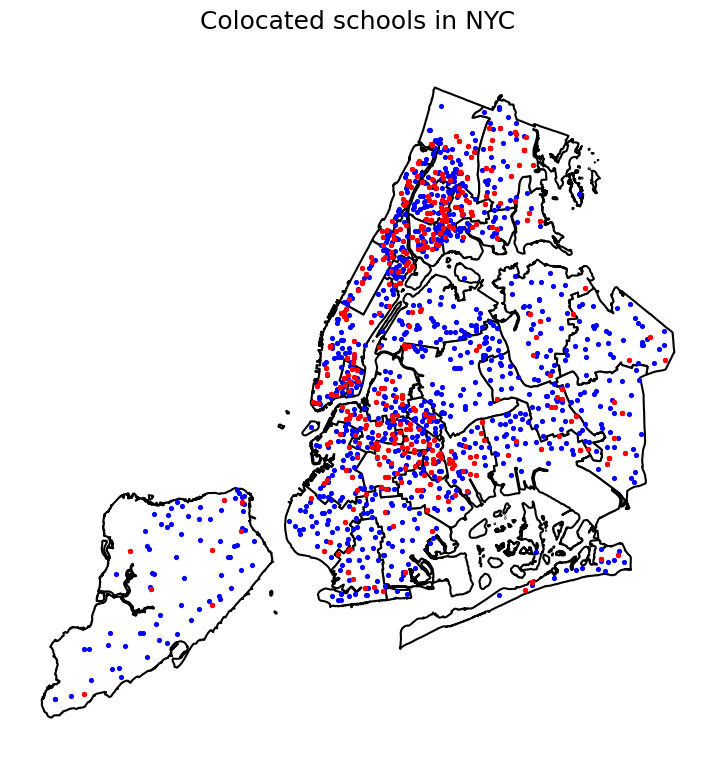

In [62]:

# plot colocated schools
loc["point"] = loc.x.astype(str) + "," + loc.y.astype(str)
coloc = loc[["dbn", "point"]].groupby("point").count().reset_index()
coloc["colocated"] = coloc["dbn"] > 1
data = loc.merge(coloc, on="point", how="inner")
data = data[['point', 'geometry', 'colocated']]

# configure the look of our map
fig, ax = plt.subplots(figsize=(16, 9))
fig.patch.set_facecolor('white')
sns.set_context('talk')
plt.axis('off')

ax.set_title( "Colocated schools in NYC", color="black", pad=20)

ax = districts.plot(ax=ax, color="white", edgecolor="black")
data[data.colocated == False].plot(ax=ax, color="blue", markersize=5)
data[data.colocated == True].plot(ax=ax, color="red", markersize=5)
plt.show()